<a href="https://colab.research.google.com/github/sugiyama404/SimpleReinforceLearning/blob/main/CartPole_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install keras-rl pyvirtualdisplay
!pip install tensorflow-gpu==1.14.0 tensorflow==1.14.0 stable-baselines gym-anytrading gym
!apt install xvfb

     |████████████████████████████████| 377.1MB 43kB/s 
     |████████████████████████████████| 109.3MB 110kB/s 
     |████████████████████████████████| 491kB 39.3MB/s 
     |████████████████████████████████| 3.2MB 30.4MB/s 
ERROR: kapre 0.3.5 has requirement tensorflow>=2.0.0, but you'll have tensorflow 1.14.0 which is incompatible.
  Found existing installation: tensorflow-estimator 1.15.1
    Uninstalling tensorflow-estimator-1.15.1:
      Successfully uninstalled tensorflow-estimator-1.15.1
  Found existing installation: tensorboard 1.15.0
    Uninstalling tensorboard-1.15.0:
      Successfully uninstalled tensorboard-1.15.0
  Found existing installation: tensorflow-gpu 1.15.0
    Uninstalling tensorflow-gpu-1.15.0:
      Successfully uninstalled tensorflow-gpu-1.15.0
  Found existing installation: tensorflow 1.15.0
    Uninstalling tensorflow-1.15.0:
      Successfully uninstalled tensorflow-1.15.0
Reading package lists... Done
Building dependency tree       
Reading state informa

Animation size has reached 20973532 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


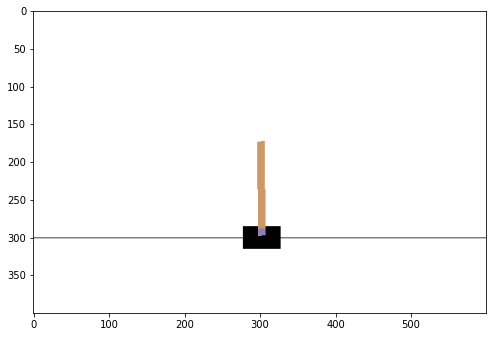

In [1]:
import gym
from IPython import display
from pyvirtualdisplay import Display
import matplotlib.pyplot as plt
from matplotlib import animation
from stable_baselines.bench import Monitor
from stable_baselines.common.policies import MlpPolicy
from stable_baselines.common.vec_env import DummyVecEnv
from stable_baselines import PPO2

d = Display()
d.start()

env = gym.make('CartPole-v1')
env = DummyVecEnv([lambda: env])

# モデルの生成
model = PPO2(MlpPolicy, env, verbose=0)

# モデルの学習
model.learn(total_timesteps=10000)
state = env.reset()

img = []
for _ in range(10000):
    env.render()
    action, _ = model.predict(state)
    o, r, d, i = env.step(action)

    display.clear_output(wait=True)
    img.append(env.render('rgb_array'))

    if d:
        env.reset()

dpi = 72
interval = 50

plt.figure(figsize=(img[0].shape[1]/dpi,img[0].shape[0]/dpi),dpi=dpi)
patch = plt.imshow(img[0])
plt.axis=('off')
animate = lambda i: patch.set_data(img[i])
ani = animation.FuncAnimation(plt.gcf(),animate,frames=len(img),interval=interval)
display.display(display.HTML(ani.to_jshtml()))